<a href="https://colab.research.google.com/github/hamster-with-human-hands/spatial-design-studio/blob/main/iter_4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!nvidia-smi

Sat Nov  4 09:11:12 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   37C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!pip install diffusers==0.11.1 transformers ftfy accelerate


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 524.9/524.9 kB 9.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.9/7.9 MB 81.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 7.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 261.4/261.4 kB 33.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.0/302.0 kB 35.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.8/3.8 MB 95.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 68.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 295.0/295.0 kB 34.6 MB/s eta 0:00:00


In [ ]:
from huggingface_hub import notebook_login

notebook_login()

## Image2Image pipeline.

In [ ]:
import inspect
import warnings
from typing import List, Optional, Union

import torch
from tqdm.auto import tqdm

from diffusers import StableDiffusionImg2ImgPipeline

Load the pipeline

In [ ]:
device = "cuda"
model_path = "CompVis/stable-diffusion-v1-4"

pipe = StableDiffusionImg2ImgPipeline.from_pretrained(
    model_path,
    torch_dtype=torch.float16,
)
pipe = pipe.to(device)

text_encoder/pytorch_model.fp16.safetensors not found


Fetching 30 files:   0%|          | 0/30 [00:00<?, ?it/s]

The config attributes {'scaling_factor': 0.18215} were passed to AutoencoderKL, but are not expected and will be ignored. Please verify your config.json configuration file.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


Download an initial image and preprocess it so we can pass it to the pipeline.

In [ ]:
import requests
from io import BytesIO
from PIL import Image

# Specify the path to the local file you want to open
file_path = "/content/audi_amd (1).png"

try:
    with open(file_path, "rb") as file:
        init_img = Image.open(file).convert("RGB")
        init_img.thumbnail((768, 768))
        # You can now work with the 'init_image' object in your code.
except FileNotFoundError:
    print(f"The file '{file_path}' was not found.")
except Exception as e:
    print(f"An error occurred while opening the file: {str(e)}")



# file_path = "/content/canteen_amd_2.png"

# response = requests.get(file_path)
# init_img = Image.open(BytesIO(response.content)).convert("RGB")
# init_img = init_img.resize((768, 512))
# init_img

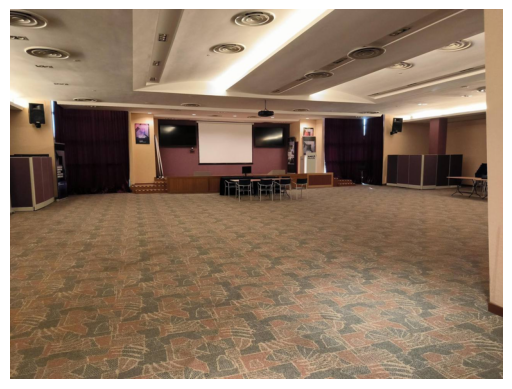

In [ ]:
!pip install matplotlib

import matplotlib.pyplot as plt

# Specify the path to the local file you want to open
file_path = "/content/audi_amd (1).png"

try:
    with open(file_path, "rb") as file:
        init_img = Image.open(file).convert("RGB")
        init_img.thumbnail((768, 768))

        # Display the image
        plt.imshow(init_img)
        plt.axis('off')  # Turn off axis labels and ticks
        plt.show()
except FileNotFoundError:
    print(f"The file '{file_path}' was not found.")
except Exception as e:
    print(f"An error occurred while opening the file: {str(e)}")


Define the prompt and run the pipeline.

In [ ]:
# prompt = "scandinavian floorplan with greenery"
prompt = 'Wooden scandinavian auditorium floorplan with greenery, modular seating, large crowd'

Here, `strength` is a value between 0.0 and 1.0, that controls the amount of noise that is added to the input image. Values that approach 1.0 allow for lots of variations but will also produce images that are not semantically consistent with the input.

  0%|          | 0/35 [00:00<?, ?it/s]

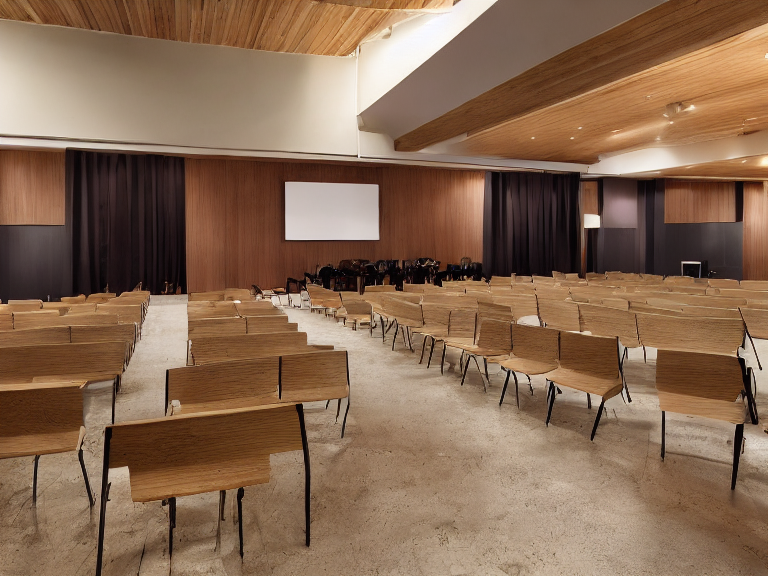

In [ ]:
generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.7, guidance_scale=7, generator=generator).images[0]
image

  0%|          | 0/30 [00:00<?, ?it/s]

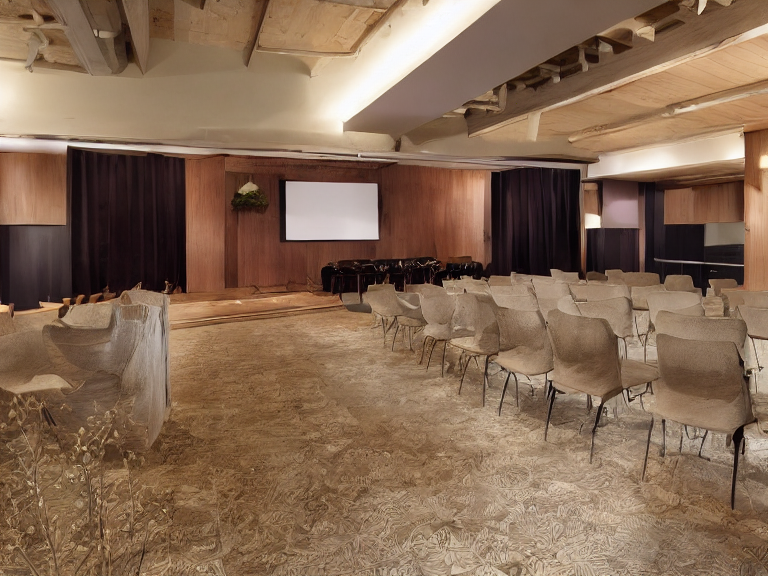

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery"

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.6, guidance_scale=3, generator=generator).images[0]
image

As you can see, when using a lower value for `strength`, the generated image is more closer to the original `image`

  0%|          | 0/40 [00:00<?, ?it/s]

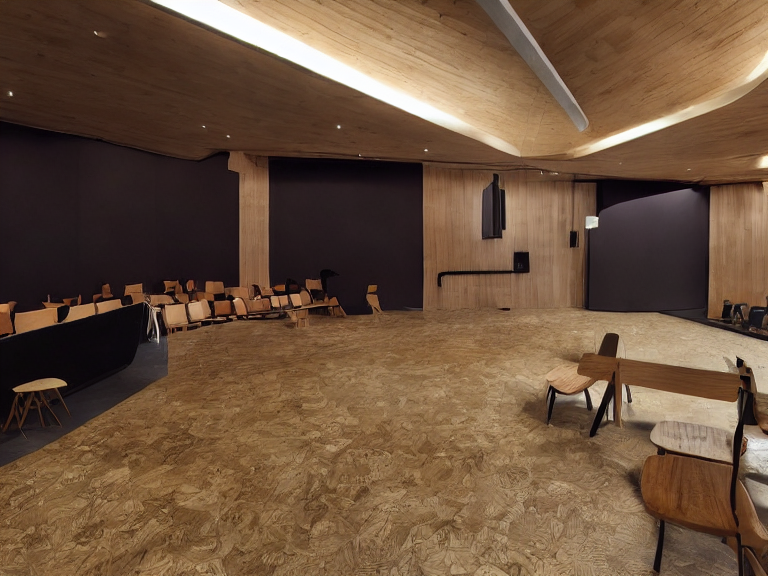

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery"

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.8, guidance_scale=3, generator=generator).images[0]
image

  0%|          | 0/37 [00:00<?, ?it/s]

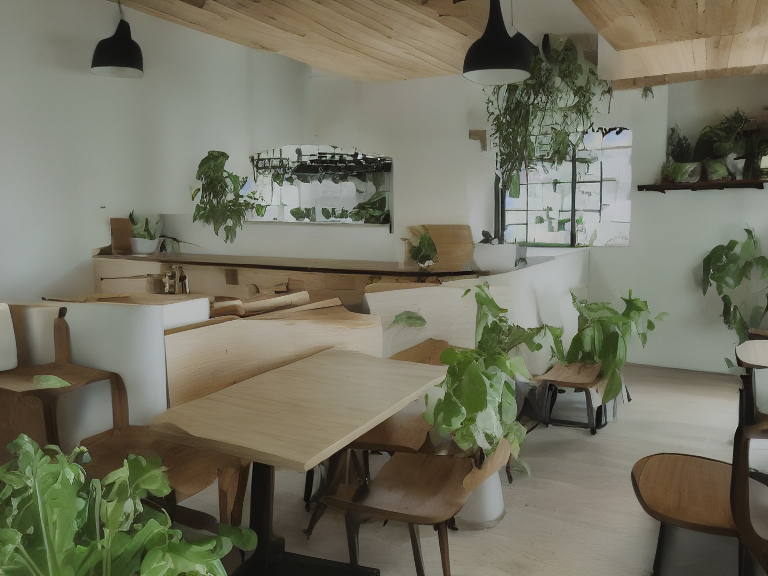

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery"

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.75, guidance_scale=3, generator=generator).images[0]
image

  0%|          | 0/42 [00:00<?, ?it/s]

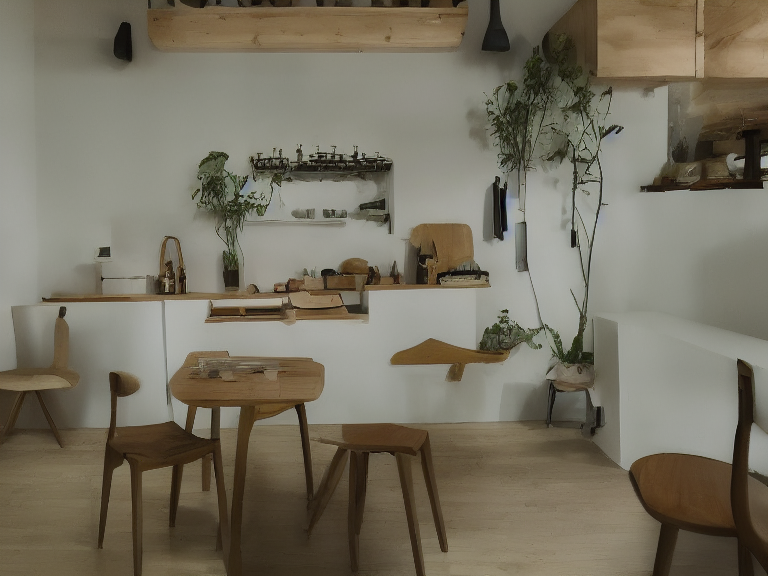

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery"

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.85, guidance_scale=3, generator=generator).images[0]
image

  0%|          | 0/45 [00:00<?, ?it/s]

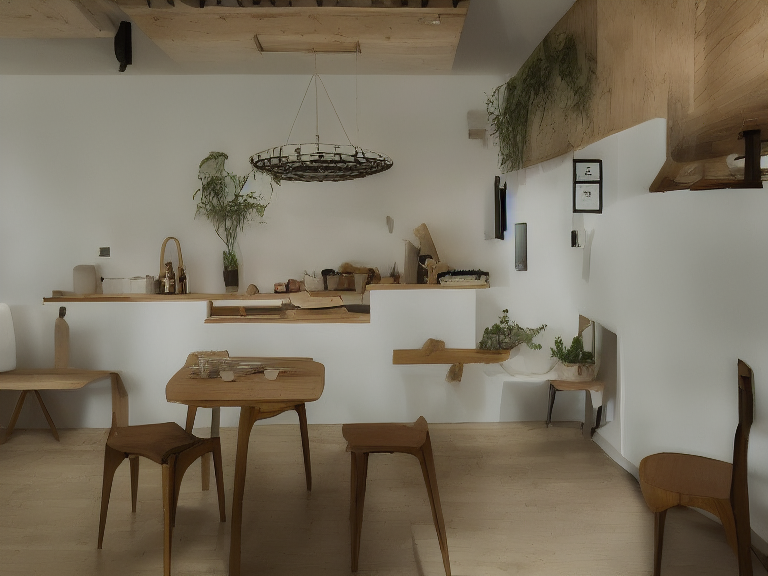

In [ ]:
generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.9, guidance_scale=3, generator=generator).images[0]
image

  0%|          | 0/40 [00:00<?, ?it/s]

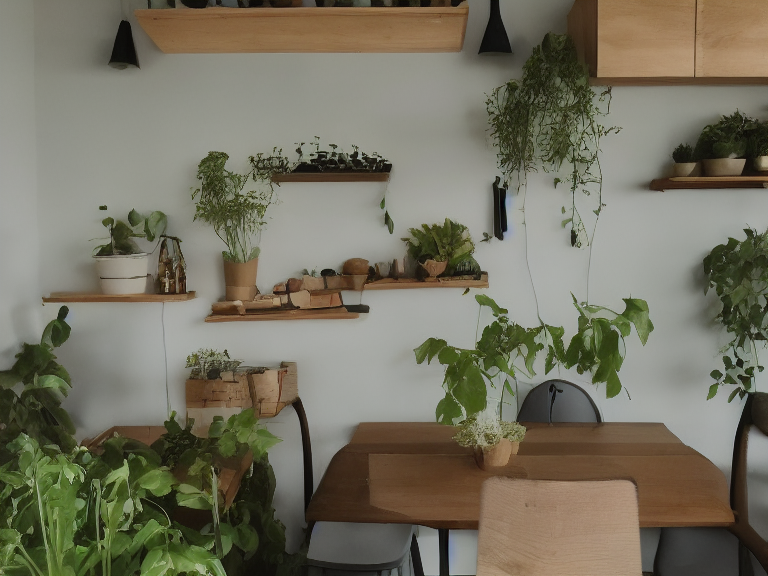

In [ ]:
generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.8, guidance_scale=5, generator=generator).images[0]
image

# strength 0.7 - 0.8 is best

  0%|          | 0/40 [00:00<?, ?it/s]

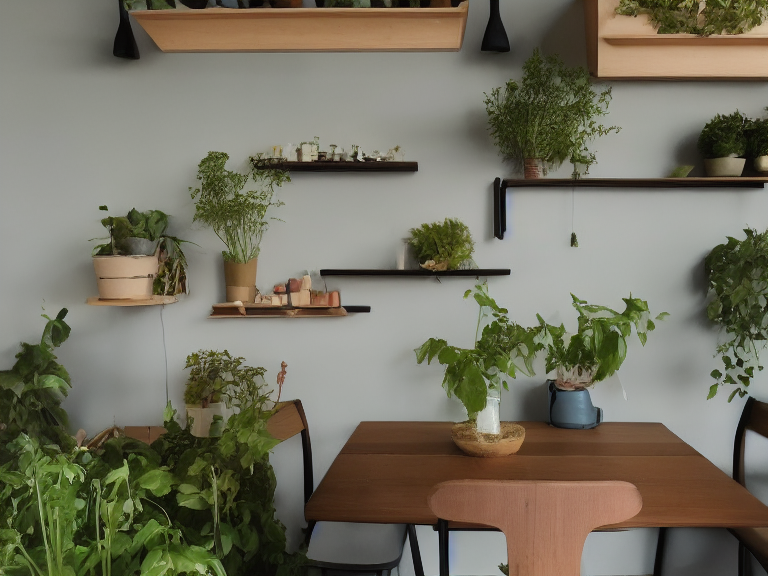

In [ ]:
generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.8, guidance_scale=8, generator=generator).images[0]
image

  0%|          | 0/42 [00:00<?, ?it/s]

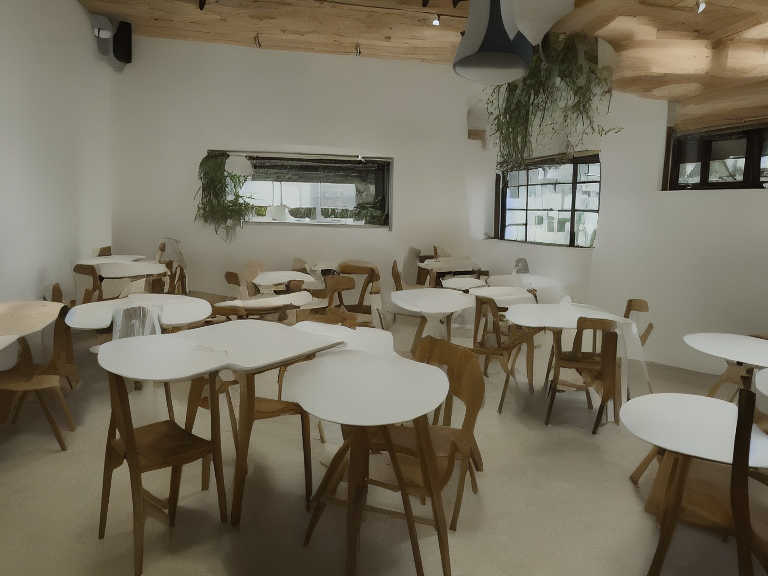

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery, modular furniture"
prompt = 'Wooden scandinavian canteen with greenery, 100 pax'

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.85, guidance_scale=3, generator=generator).images[0]
image

  0%|          | 0/35 [00:00<?, ?it/s]

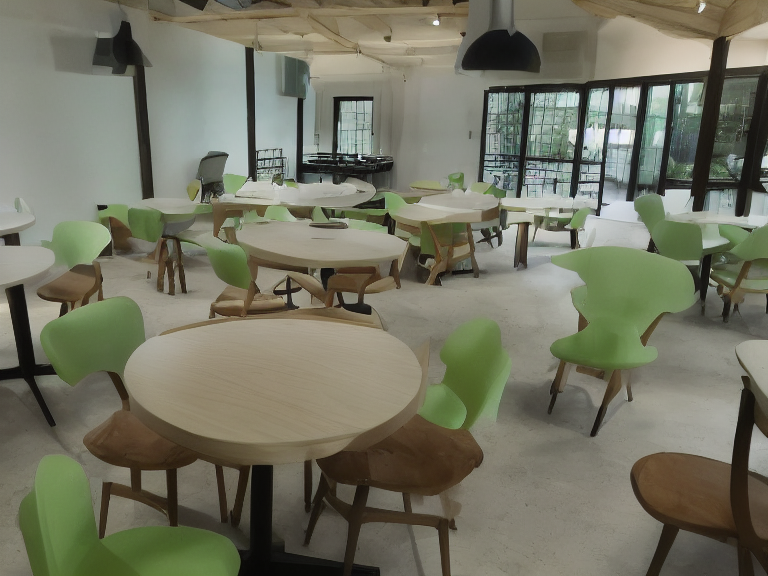

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery, modular furniture"

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.7, guidance_scale=3, generator=generator).images[0]
image

  0%|          | 0/37 [00:00<?, ?it/s]

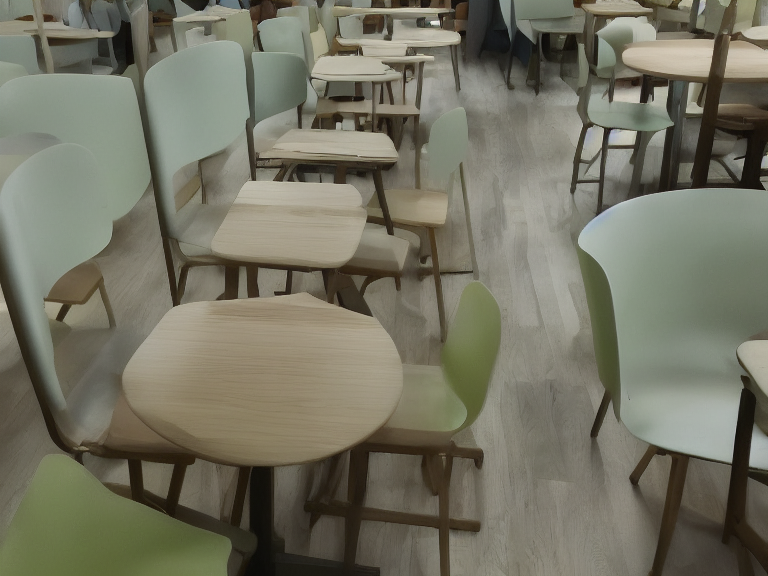

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery, modular furniture"

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.75, guidance_scale=3, generator=generator).images[0]
image

  0%|          | 0/37 [00:00<?, ?it/s]

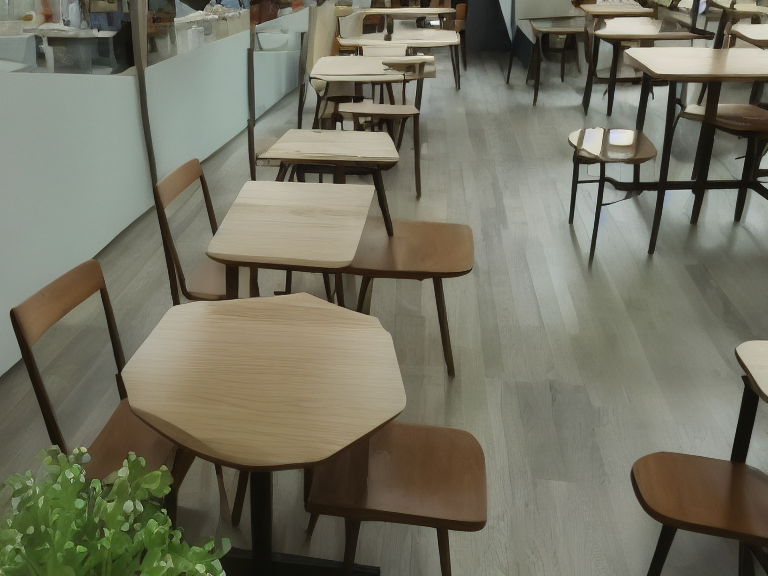

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery, modular furniture"

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.75, guidance_scale=5, generator=generator).images[0]
image

  0%|          | 0/37 [00:00<?, ?it/s]

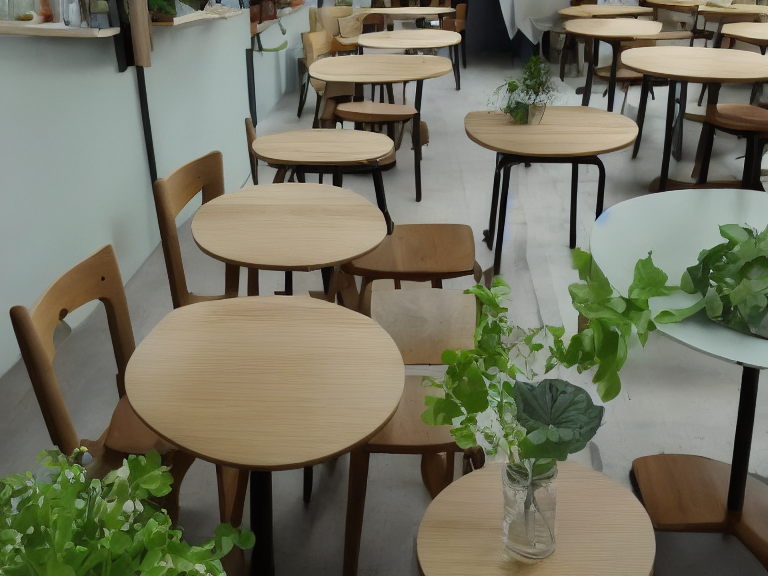

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery, modular furniture"

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.75, guidance_scale=8, generator=generator).images[0]
image


Now using [LMSDiscreteScheduler](https://huggingface.co/docs/diffusers/api/schedulers#diffusers.LMSDiscreteScheduler)

In [ ]:
from diffusers import LMSDiscreteScheduler

lms = LMSDiscreteScheduler.from_config(pipe.scheduler.config)
pipe.scheduler = lms

  0%|          | 0/45 [00:00<?, ?it/s]

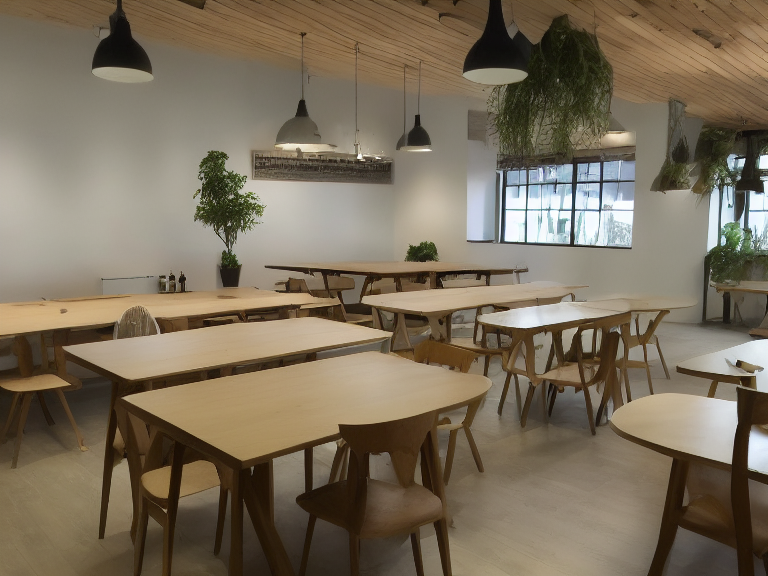

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery modular"
prompt = 'Wooden scandinavian canteen with greenery, 100 pax'

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.9, guidance_scale=7, generator=generator).images[0]
image

  0%|          | 0/40 [00:00<?, ?it/s]

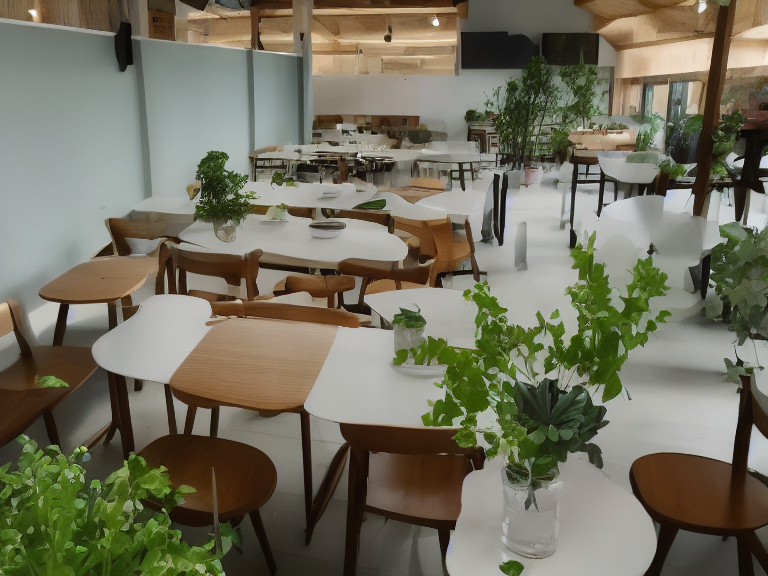

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery modular"
prompt = 'Wooden scandinavian canteen with greenery, 100 pax'

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.8, guidance_scale=7, generator=generator).images[0]
image

  0%|          | 0/35 [00:00<?, ?it/s]

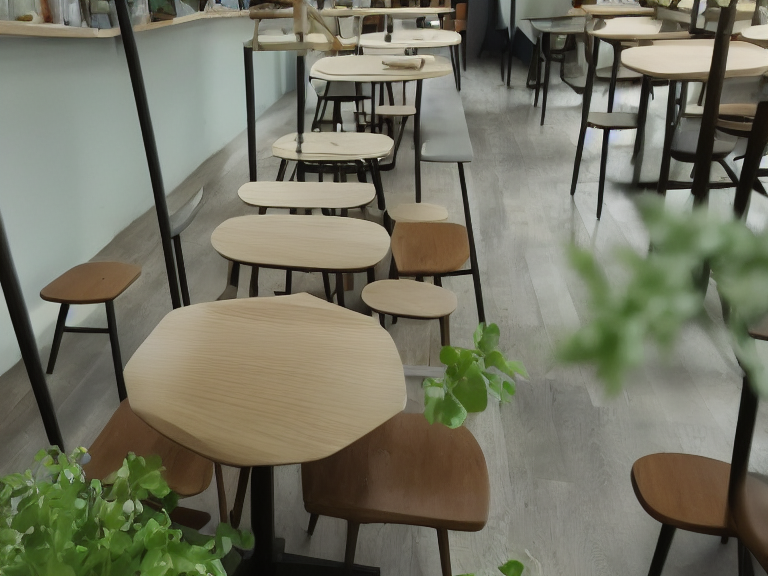

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery modular"
# prompt = 'Wooden scandinavian canteen with greenery, 100 pax'

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.7, guidance_scale=7, generator=generator).images[0]
image

  0%|          | 0/42 [00:00<?, ?it/s]

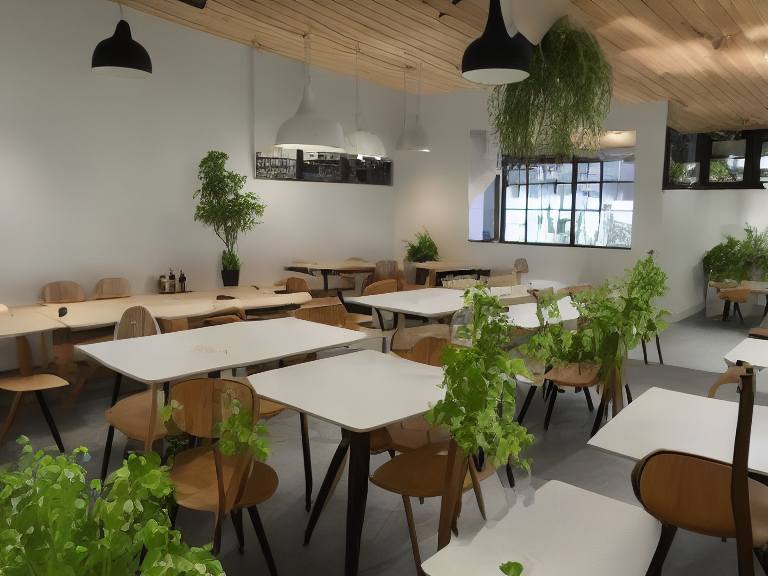

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery modular"
# prompt = 'Wooden scandinavian canteen with greenery, 100 pax'

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.85, guidance_scale=7, generator=generator).images[0]
image

  0%|          | 0/42 [00:00<?, ?it/s]

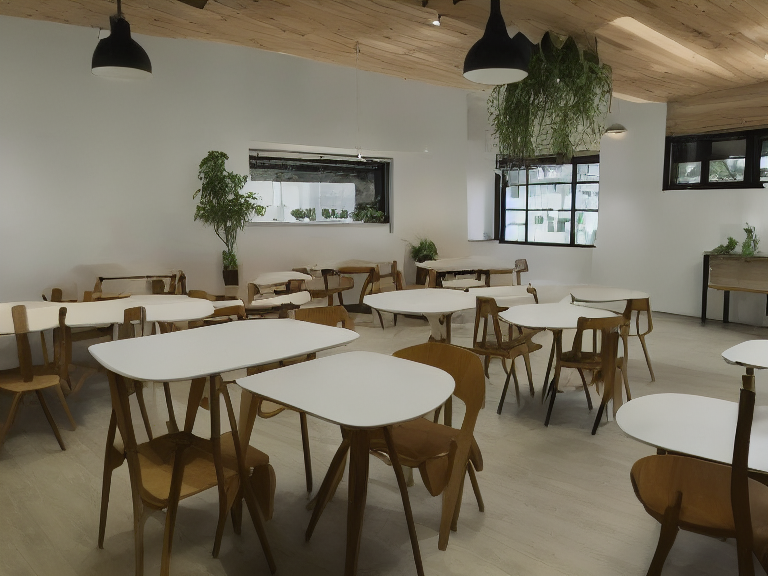

In [ ]:
prompt = "scandinavian floorplan auditorium with greenery modular"
prompt = 'Wooden scandinavian canteen with greenery, 100 pax'

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.85, guidance_scale=5, generator=generator).images[0]
image

  0%|          | 0/42 [00:00<?, ?it/s]

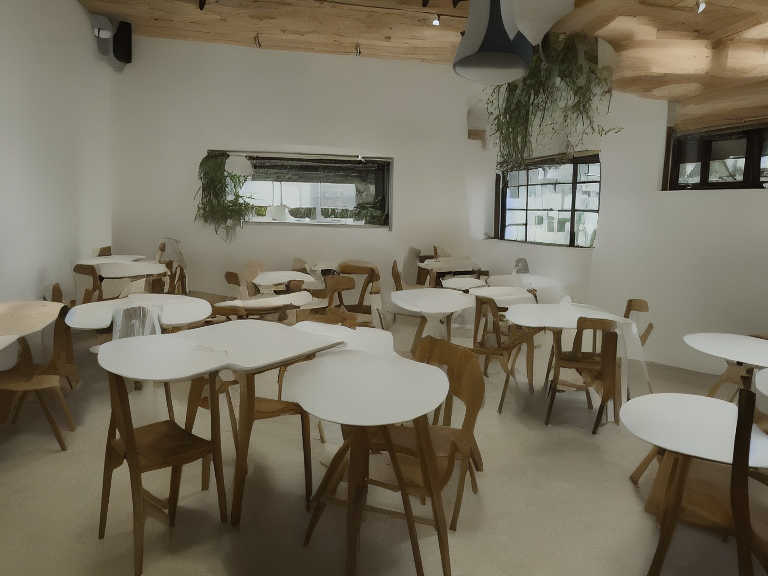

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery modular"
# prompt = 'Wooden scandinavian canteen with greenery, 100 pax'

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.85, guidance_scale=3, generator=generator).images[0]
image

  0%|          | 0/37 [00:00<?, ?it/s]

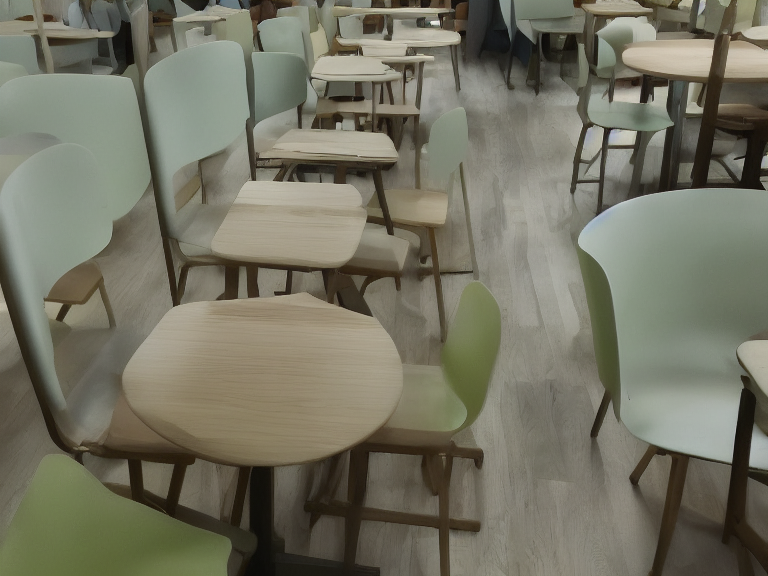

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery modular"
# prompt = 'Wooden scandinavian canteen with greenery, 100 pax'

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.75, guidance_scale=3, generator=generator).images[0]
image

  0%|          | 0/35 [00:00<?, ?it/s]

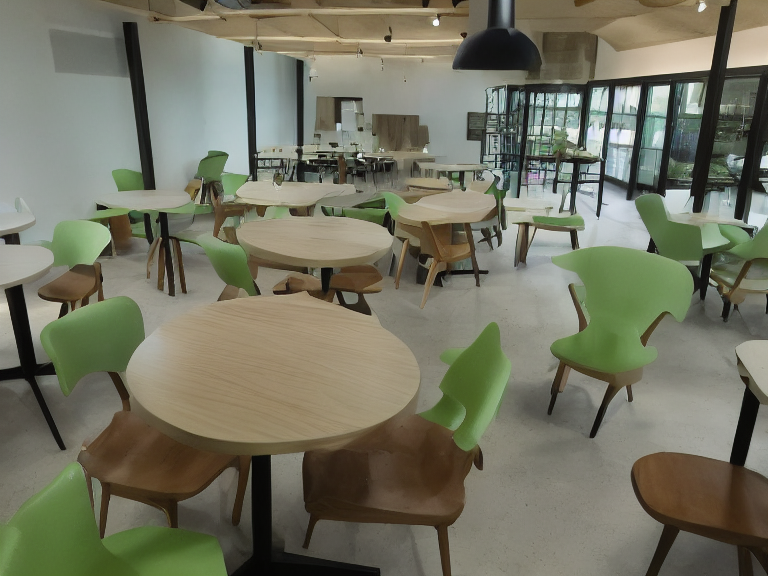

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery modular"
# prompt = 'Wooden scandinavian canteen with greenery, 100 pax'

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.7, guidance_scale=5, generator=generator).images[0]
image

  0%|          | 0/40 [00:00<?, ?it/s]

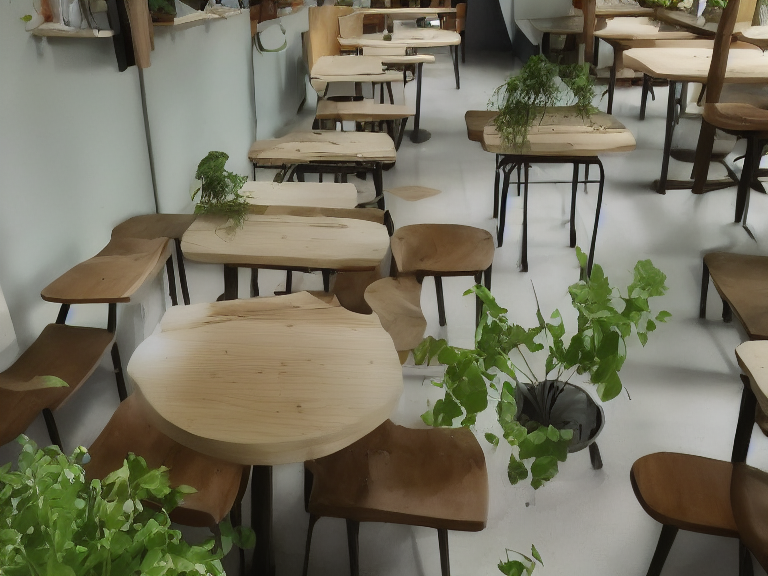

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery modular"
# prompt = 'Wooden scandinavian canteen with greenery, 100 pax'

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.8, guidance_scale=5, generator=generator).images[0]
image

In [ ]:
# change prompt here below

  0%|          | 0/45 [00:00<?, ?it/s]

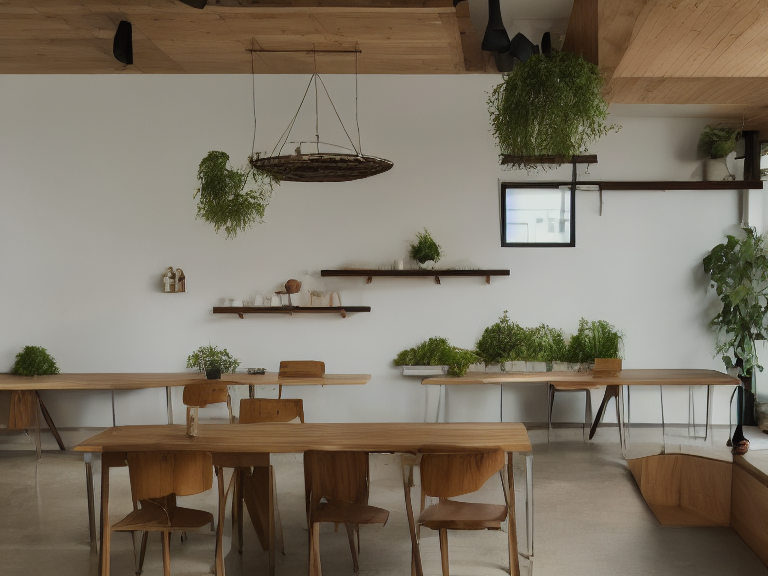

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery"
prompt = 'Wooden scandinavian canteen with greenery'

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.9, guidance_scale=7, generator=generator).images[0]
image

  0%|          | 0/40 [00:00<?, ?it/s]

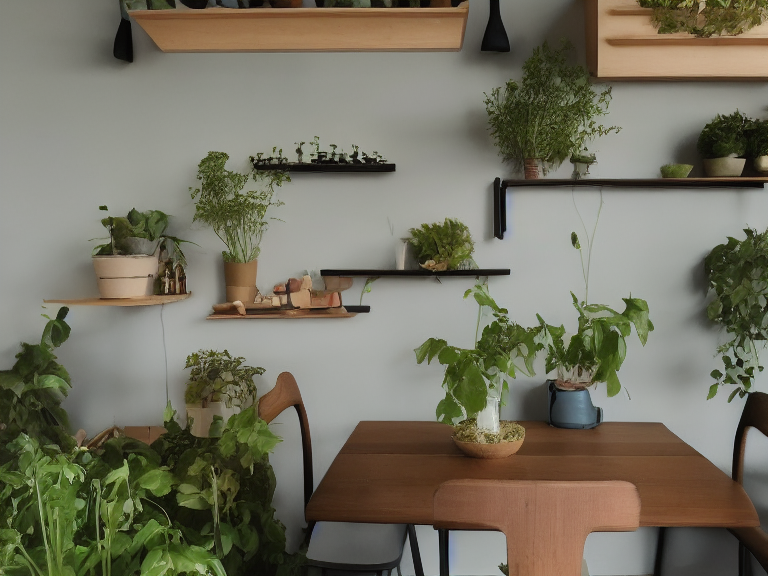

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery"

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.8, guidance_scale=7, generator=generator).images[0]
image

  0%|          | 0/37 [00:00<?, ?it/s]

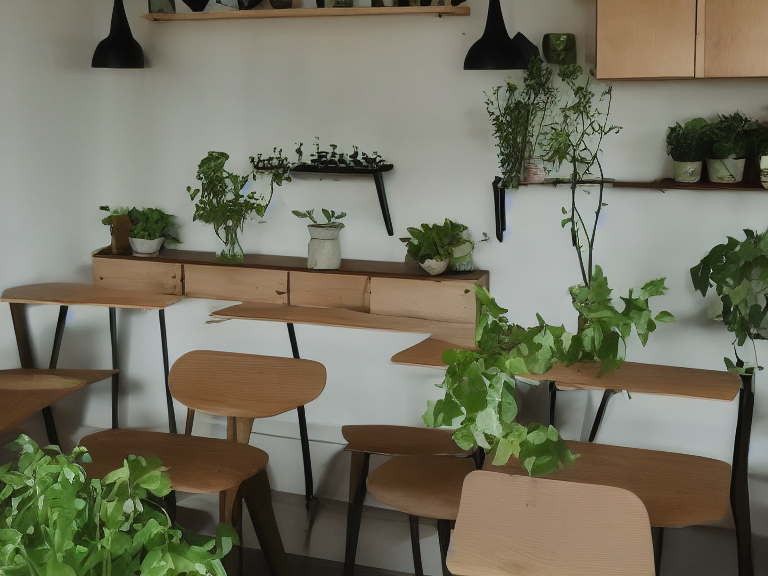

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery"

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.75, guidance_scale=7, generator=generator).images[0]
image

  0%|          | 0/35 [00:00<?, ?it/s]

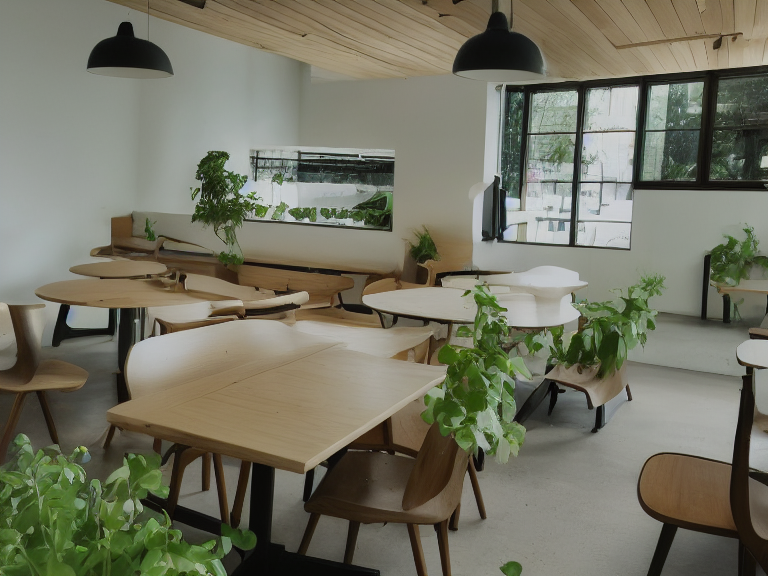

In [ ]:
# prompt = "scandinavian floorplan auditorium with greenery"

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.7, guidance_scale=7, generator=generator).images[0]
image

  0%|          | 0/35 [00:00<?, ?it/s]

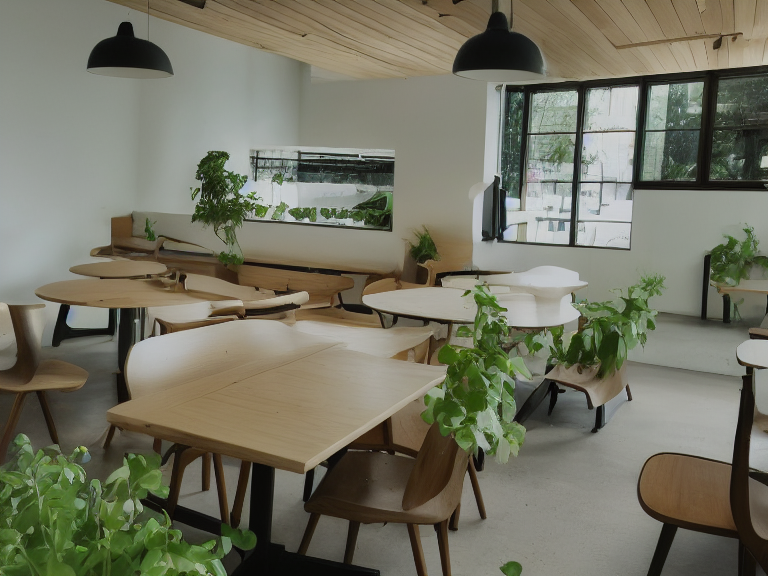

In [ ]:
# prompt = "scandinavian auditorium with greenery"

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.7, guidance_scale=7, generator=generator).images[0]
image

  0%|          | 0/25 [00:00<?, ?it/s]

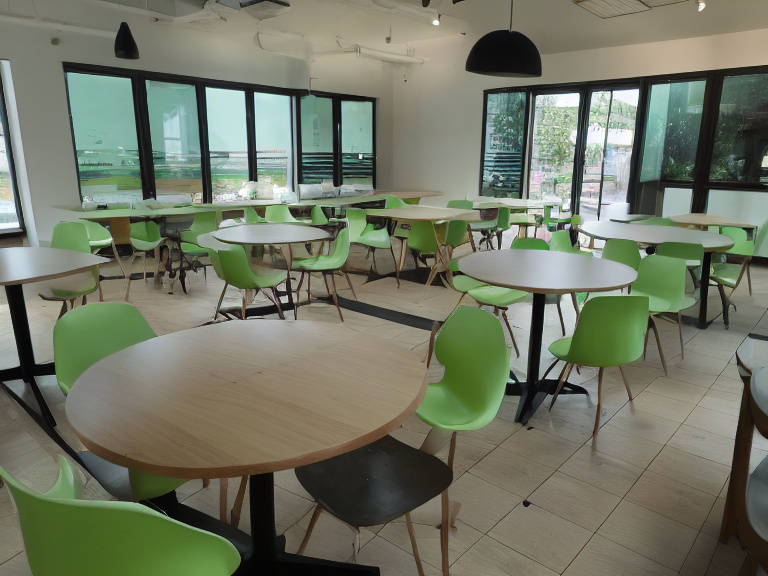

In [ ]:
# lmsDiffuser_strength0.7_guidance7_Audi

# prompt = "scandinavian auditorium with greenery"

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.5, guidance_scale=7, generator=generator).images[0]
image

  0%|          | 0/35 [00:00<?, ?it/s]

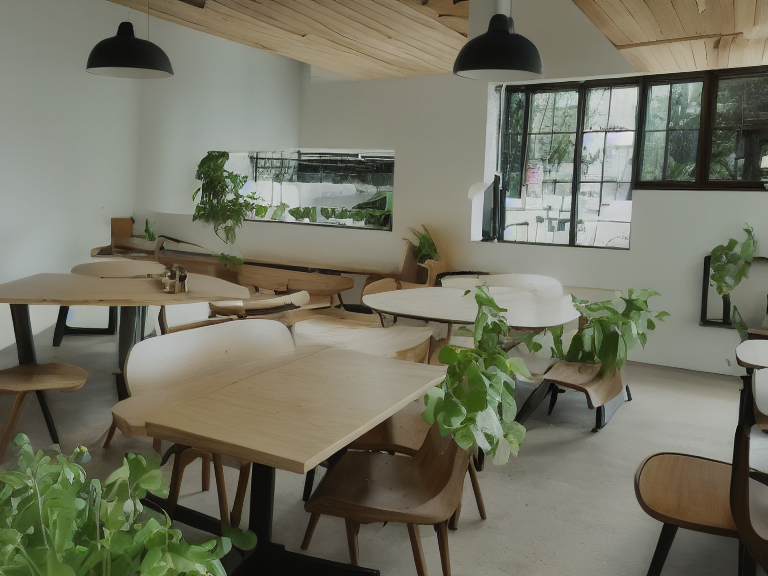

In [ ]:
# prompt = "scandinavian auditorium with greenery"

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.7, guidance_scale=5, generator=generator).images[0]
image

  0%|          | 0/35 [00:00<?, ?it/s]

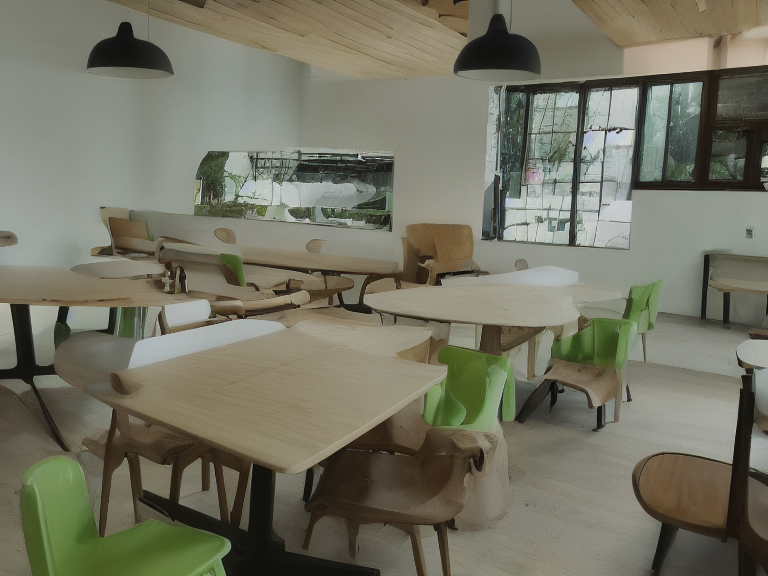

In [ ]:
# lmsDiffuser_strength0.7_guidance7_Audi

# prompt = "scandinavian auditorium with greenery"

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.7, guidance_scale=3, generator=generator).images[0]
image

  0%|          | 0/37 [00:00<?, ?it/s]

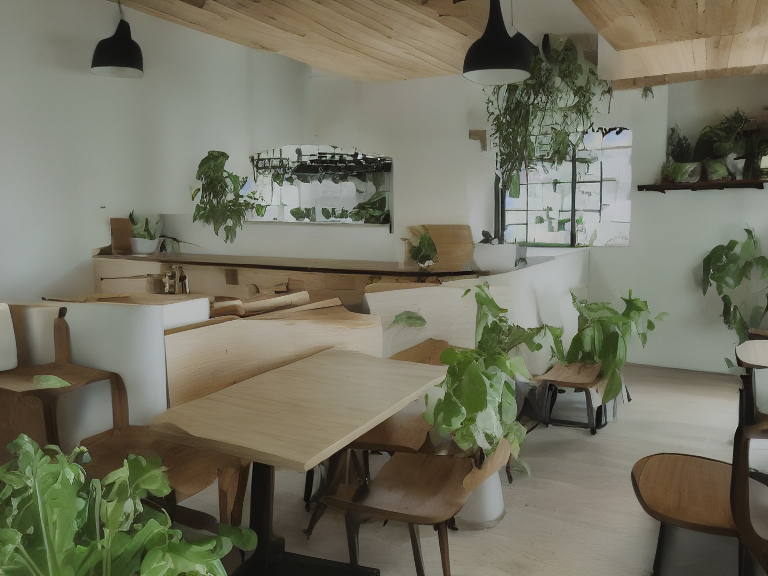

In [ ]:
# lmsDiffuser_strength0.7_guidance7_Audi

# prompt = "scandinavian auditorium with greenery"

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.75, guidance_scale=3, generator=generator).images[0]
image

  0%|          | 0/42 [00:00<?, ?it/s]

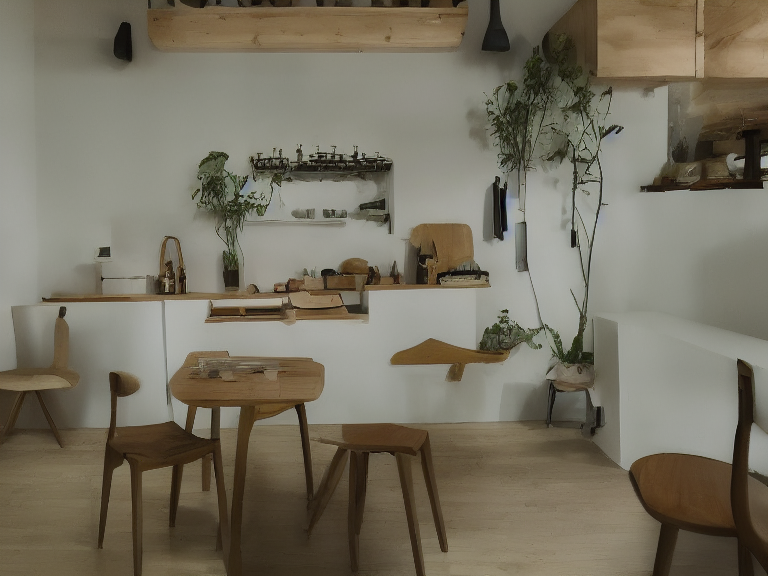

In [ ]:
# lmsDiffuser_strength0.7_guidance7_Audi

# prompt = "scandinavian auditorium with greenery"

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.85, guidance_scale=3, generator=generator).images[0]
image

  0%|          | 0/37 [00:00<?, ?it/s]

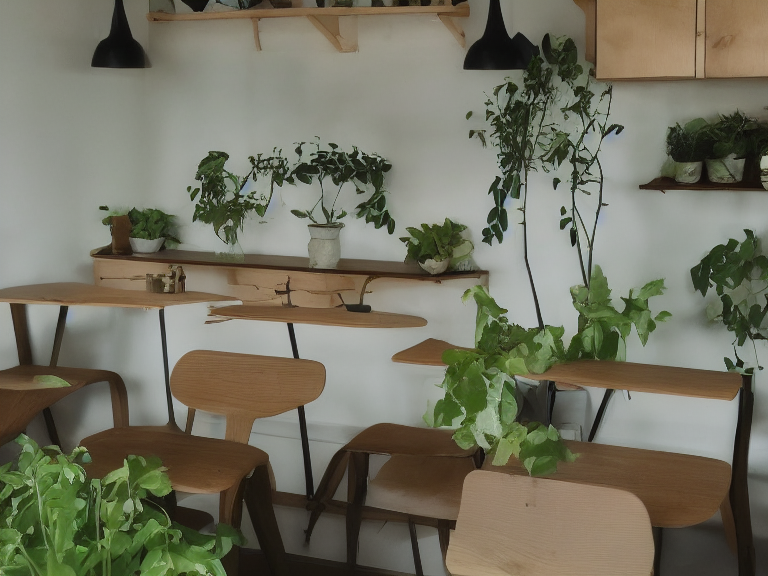

In [ ]:
# lmsDiffuser_strength0.7_guidance7_Audi

# prompt = "scandinavian auditorium with greenery"

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.75, guidance_scale=5, generator=generator).images[0]
image

  0%|          | 0/42 [00:00<?, ?it/s]

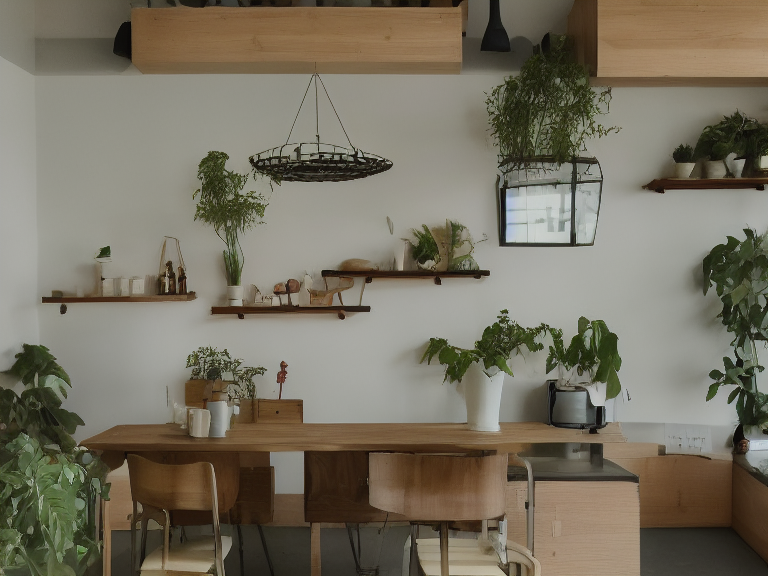

In [ ]:
# lmsDiffuser_strength0.7_guidance7_Audi

# prompt = "scandinavian auditorium with greenery"

generator = torch.Generator(device=device).manual_seed(1024)
image = pipe(prompt=prompt, image=init_img, strength=0.85, guidance_scale=5, generator=generator).images[0]
image